# TODO
- nd2 to tiff
- video viewer
    - display z coordinate, microns, time elapsed

In [1]:
import glob
import sys
import os
import subprocess
from pathlib import Path
import pandas as pd
import numpy as np
import tifffile
from nd2reader import ND2Reader
import imageio
import matplotlib.pyplot as plt
import itk
import warnings; warnings.filterwarnings('ignore', category=UserWarning, module='itk')

import dask.array as da
import nd2

from tqdm import tqdm

%matplotlib widget

In [2]:
def get_range(input_nd2, stack_length=41):
    """Returns a range object containing valid stack indices from the ND2 file."""
    with ND2Reader(input_nd2) as f:
        stack_range = range(f.metadata['num_frames'] // stack_length)
    return stack_range

def check_focus(out_dir, stack_range):
    """Checks the focus of the recording"""
    plot_path = out_dir + '/focus.png'
    if not os.path.isfile(plot_path):
        tif_files = check_files(out_dir, stack_range, 'tif')
        for i in range(0, len(tif_files), 100):
            stack = tifffile.imread(tif_files[i])
            rfp = stack[:, 1]
            color = plt.cm.viridis(i / len(tif_files))
            plt.plot(np.mean(rfp, axis=(1, 2)), color=color)
        plt.xlim(0, 38)
        plt.tight_layout()
        plt.savefig(plot_path)
        plt.close()

def check_files(out_dir, stack_range, extension):
    """Checks if all the expected files in the stack range are in the directory"""
    existing_files = set(glob.glob(out_dir + f'/{extension}/*.{extension}'))
    expected_files = {out_dir + f'/{extension}/{i:04d}.{extension}' for i in stack_range}
    if missing_files := expected_files - existing_files:
        stacks = sorted([int(os.path.splitext(os.path.basename(f))[0]) for f in missing_files])
        raise FileNotFoundError(f"Missing .{extension} files: {','.join([str(i) for i in stacks])}")
    return sorted(expected_files)

def get_transform_params(file, parameter_object):
    """Extracts transform parameters from a text file."""
    parameter_object.ReadParameterFile(file)
    return np.array(parameter_object.GetParameterMap(0)['TransformParameters'], float)

def write_alignment(out_dir, stack_range):
    """Creates an alignment file from the parameter DataFrame."""
    align_path = out_dir + '/align.txt'
    if not os.path.exists(align_path):
        parameter_object = itk.ParameterObject.New()
        alignment_files = check_files(out_dir, stack_range, 'txt')
        params = np.zeros((len(alignment_files), 3))
        for i, file in enumerate(alignment_files):
            params[i] = get_transform_params(file, parameter_object)
        param_df = pd.DataFrame(params, columns=['theta', 't_x', 't_y'])
        param_df.to_csv(out_dir + '/params.csv')

        median_params = np.median(param_df.to_numpy(), axis=0)
        parameter_object.ReadParameterFile('/home/albert_w/scripts/template.txt')
        changed_param_map = parameter_object.GetParameterMap(0)
        changed_param_map['TransformParameters'] = [f'{i:.15f}' for i in median_params]
        parameter_object.SetParameterMap(0, changed_param_map)
        parameter_object.WriteParameterFile(parameter_object, align_path)

        plt.subplot(311)
        plt.hist(param_df['theta'], bins=100)
        plt.axvline(median_params[0], color='k', linestyle='--')  
        plt.title(r'$\theta$')
        plt.subplot(312)
        plt.hist(param_df['t_x'], bins=100)
        plt.axvline(median_params[1], color='k', linestyle='--')
        plt.title(r'$t_x$')
        plt.subplot(313)
        plt.hist(param_df['t_y'], bins=100)
        plt.axvline(median_params[2], color='k', linestyle='--')
        plt.title(r'$t_y$')
        plt.tight_layout()
        plt.savefig(out_dir + '/align.png')
        plt.close()

def write_mip(out_dir, stack_range):
    """Combines multiple TIF files into a single output file using tifffile."""
    mip_path = out_dir + '/mip.tif'
    if not os.path.exists(mip_path):
        tif_files = check_files(out_dir, stack_range, 'tif')
        
        parameter_object = itk.ParameterObject.New()
        parameter_object.ReadParameterFile(out_dir + '/align.txt')
        with tifffile.TiffWriter(mip_path, bigtiff=True, imagej=True) as tif:
            for tif_file in tif_files:
                stack = tifffile.imread(tif_file)
                gfp, rfp = np.max(stack, axis=0).astype(np.float32)
                gfp_reg = itk.transformix_filter(gfp, parameter_object)
                tif.write(np.stack([gfp_reg, rfp], axis=0).clip(0, 4095).astype(np.uint16), contiguous=True)
                print(f'{os.path.basename(tif_file)} written to mip.tif')

        mip = tifffile.imread(mip_path)
        gfp_means, rfp_means = np.mean(mip, axis=(2, 3)).T
        plt.subplot(211)
        plt.plot(gfp_means, c='C2')
        plt.xlim(0, len(mip))
        plt.title(f'Max GFP mean: index {np.argmax(gfp_means)}')
        plt.subplot(212)
        plt.plot(rfp_means, c='C3')
        plt.xlim(0, len(mip))
        plt.title(f'Max RFP mean: index {np.argmax(rfp_means)}')
        plt.tight_layout()
        plt.savefig(out_dir + '/means.png')
        plt.close()

def make_rgb(frame, shape=(512, 512, 3)):
    """Creates an RGB image from a frame."""
    gfp, rfp = frame
    rgb = np.zeros(shape, np.ubyte)
    adjust = lambda frame, lo, hi: np.clip((frame.astype(np.float32) - lo) / (hi - lo), 0, 1)
    rgb[..., 0] = adjust(rfp, 0, 400) * 255
    rgb[..., 1] = adjust(gfp, 0, 100) * 255
    return rgb

def write_mp4(out_dir):
    """Creates an AVI file from a MIP TIF file."""
    mp4_path = out_dir + '/mip.mp4'
    if not os.path.exists(mp4_path):
        mip = tifffile.imread(out_dir + '/mip.tif')
        with imageio.get_writer(out_dir + '/mip.mp4', fps=5/0.533) as mp4:
            for frame in mip:
                mp4.append_data(make_rgb(frame))

In [3]:

def nd2_to_tiffs(input_path, output_dir=None, channel=None):
    """
    Convert an ND2 file into a sequence of TIFF frames.

    Parameters
    ----------
    input_path : str
        Path to the .nd2 file.
    output_dir : str or None
        Directory to save frames; defaults to "<input>_tif".
    channel : int or None
        If the ND2 has multiple channels, pick one (0-based).
        If None and ND2 is multi-channel, it will save the selected channel (0).

    Returns
    -------
    out_dir : str
        Path to the directory containing the extracted TIFFs.
    n_frames : int
        Number of TIFFs written.
    """
    if not os.path.isfile(input_path):
        raise FileNotFoundError(f"Input file not found: {input_path}")

    if output_dir is None:
        output_dir = os.path.splitext(input_path)[0] + "_tif"
    os.makedirs(output_dir, exist_ok=True)

    n_written = 0
    with ND2Reader(input_path) as images:
        sizes = dict(images.sizes)  # e.g. {'x': 2048, 'y': 2048, 't': 100, 'z': 41, 'c': 2}

        # Decide how to iterate: prefer time, else z, else a flat sequence
        if 't' in sizes and sizes['t'] > 1:
            images.iter_axes = 't'
        elif 'z' in sizes and sizes['z'] > 1:
            images.iter_axes = 'z'
        else:
            images.iter_axes = ''  # single plane or unrolled frames

        # Bundle axes so each yielded item is 2D (yx) or 3D (cyx) if multi-channel
        if 'c' in sizes and sizes['c'] > 1:
            images.bundle_axes = 'cyx'
            sel_ch = channel if channel is not None else 0
            for i, frame in enumerate(images):
                # frame shape: (C, Y, X)
                if sel_ch < 0 or sel_ch >= frame.shape[0]:
                    raise ValueError(f"Requested channel {sel_ch} but ND2 has {frame.shape[0]} channels.")
                img = frame[sel_ch]
                tifffile.imwrite(os.path.join(output_dir, f"{i+1:06d}.tif"), img, photometric='minisblack')
                n_written += 1
        else:
            images.bundle_axes = 'yx'
            for i, frame in enumerate(images):
                # frame shape: (Y, X)
                tifffile.imwrite(os.path.join(output_dir, f"{i+1:06d}.tif"), frame, photometric='minisblack')
                n_written += 1

    return output_dir, n_written


In [4]:


# def nd2_to_tiff(input_path, output_dir=None):
#     """
#     Convert a .nd2 microscopy video file to a series of .tiff frames using ffmpeg.
#     # ffmpeg doesn't support nd2 files natively. there's custom support builds but just gonna see if nd2reader will do the trick

#     Parameters
#     ----------
#     input_path : str
#         Path to the input .nd2 file.
#     output_dir : str, optional
#         Directory to save the output TIFF frames. If None, saves in the same directory as the input.

#     Returns
#     -------
#     output_pattern : str
#         The file pattern for the generated TIFF frames.
#     """

#     # Validate input
#     if not os.path.isfile(input_path):
#         raise FileNotFoundError(f"Input file not found: {input_path}")
#     if not input_path.lower().endswith(".nd2"):
#         raise ValueError("Input file must have a .nd2 extension")

#     # Prepare output directory
#     if output_dir is None:
#         output_dir = os.path.splitext(input_path)[0] + "_tif"
#     os.makedirs(output_dir, exist_ok=True)

#     # Define output pattern
#     output_pattern = os.path.join(output_dir, "%06d.tif")

#     # Build ffmpeg command
#     cmd = [
#         "ffmpeg",
#         "-hide_banner",
#         "-loglevel", "error",   # suppress verbose logs
#         "-i", input_path,       # input file
#         "-pix_fmt", "gray",     # grayscale output (or use "rgb24" if color)
#         output_pattern
#     ]

#     # Run the command
#     print(f"Converting {input_path} → {output_pattern} ...")
#     subprocess.run(cmd, check=True)
#     print("Conversion complete!")

#     return output_pattern


In [5]:

def _ensure_axes(arr, axes_str, target_axes="TCZYX"):
    """
    Reorder/expand array to match target_axes.
    Returns (arr_reordered, axes_str_reordered)
    """
    # Add any missing singleton axes in the order they appear in target_axes
    for ax in target_axes:
        if ax not in axes_str:
            # add leading axis (we'll reorder later)
            arr = da.expand_dims(arr, axis=0)
            axes_str = ax + axes_str

    # Now build permutation to go from current axes_str -> target_axes
    perm = [axes_str.index(ax) for ax in target_axes]
    arr = arr.transpose(perm)
    axes_str = target_axes
    return arr, axes_str

def nd2_to_tiff(
    input_path,
    output_dir=None,
    mode="per_time_ome",   # "per_time_ome" | "single_ome" | "per_channel_time"
    stack_length=41,       # number of z-slices per frame
    compression="None",    # "zlib" (fast, lossless), or None for uncompressed
    bigtiff=False,          # safer for large files
    overwrite=True,
):
    """
    Convert ND2 (T, Z, C) to TIFF/OME-TIFF with correct axes.

    Parameters
    ----------
    input_path : str or Path
        ND2 file path.
    output_dir : str or Path or None
        Output directory. Defaults to <input_stem>_tif.
    mode : str
        - "per_time_ome": one OME-TIFF per time index, each with axes CZYX.
        - "single_ome": one big OME-TIFF with axes TCZYX (all timepoints).
        - "per_channel_time": one OME-TIFF per (time, channel) with axes ZYX.
    compression : str or None
        Passed to tifffile.imwrite(compression=...).
    bigtiff : bool
        Enable BigTIFF for large files.
    overwrite : bool
        Overwrite existing outputs.

    Returns
    -------
    dict
        Summary with counts and output paths.
    """
    input_path = Path(input_path)
    if output_dir is None:
        output_dir = input_path.with_suffix("").as_posix() + "_tif"
    output_dir = Path(output_dir)
    output_dir.mkdir(parents=True, exist_ok=True)

    with nd2.ND2File(input_path) as f:
        # dask array with axes string like "TCZYX" (order can vary)
        arr = f.to_dask()
        axes = f.axes  # e.g., 'TCZYX', 'TZCYX', etc.

        # Reorder to TCZYX and add missing singleton axes if needed
        arr, axes = _ensure_axes(arr, axes, target_axes="TCZYX")

        T = arr.shape[0]
        C = arr.shape[1]
        Z = arr.shape[2]
        Y = arr.shape[3]
        X = arr.shape[4]

        basename = input_path.stem

        if mode == "per_time_ome":
            # One file per time point: axes CZYX
            for t in tqdm(range(T), desc="Writing OME-TIFF (per time)"):
                stack_czyx = arr[t]  # shape (C, Z, Y, X), dask
                # Compute per-timepoint to avoid huge memory spikes
                stack_czyx_np = np.asarray(stack_czyx)  # dask -> numpy
                out_pth = output_dir / f"{basename}_t{t:04d}.ome.tif"
                if out_pth.exists() and not overwrite:
                    continue
                tifffile.imwrite(
                    out_pth,
                    stack_czyx_np,
                    ome=True,
                    # OME needs correct axes string:
                    metadata={"axes": "CZYX"},
                    compression=compression,
                    bigtiff=bigtiff,
                )
            return {
                "mode": mode,
                "T": T, "C": C, "Z": Z, "Y": Y, "X": X,
                "out_dir": str(output_dir),
                "files": "one per timepoint (CZYX)",
            }

        elif mode == "single_ome":
            # One big file: axes TCZYX
            out_pth = output_dir / f"{basename}.ome.tif"
            if out_pth.exists() and not overwrite:
                return {
                    "mode": mode, "note": "file exists and overwrite=False",
                    "out_file": str(out_pth)
                }
            # Write as OME with axes string
            # Write in chunks to avoid loading all into RAM: use tifffile's dask support
            tifffile.imwrite(
                out_pth,
                arr,                 # dask array is fine
                ome=True,
                metadata={"axes": "TCZYX"},
                compression=compression,
                bigtiff=bigtiff,
            )
            return {
                "mode": mode,
                "T": T, "C": C, "Z": Z, "Y": Y, "X": X,
                "out_file": str(out_pth),
            }

        elif mode == "per_channel_time":
            # One file per (time, channel): axes ZYX
            for t in tqdm(range(T), desc="Writing per (time, channel)"):
                for c in range(C):
                    stack_zyx = arr[t, c]  # (Z, Y, X)
                    stack_zyx_np = np.asarray(stack_zyx)
                    out_pth = output_dir / f"{basename}_t{t:04d}_c{c}.ome.tif"
                    if out_pth.exists() and not overwrite:
                        continue
                    tifffile.imwrite(
                        out_pth,
                        stack_zyx_np,
                        ome=True,
                        metadata={"axes": "ZYX"},
                        compression=compression,
                        bigtiff=bigtiff,
                    )
            return {
                "mode": mode,
                "T": T, "C": C, "Z": Z, "Y": Y, "X": X,
                "out_dir": str(output_dir),
                "files": "one per (time, channel) (ZYX)",
            }

        else:
            raise ValueError(f"Unknown mode: {mode}")


In [6]:

def _ensure_axes(arr, axes_str, target_axes="TCZYX"):
    """Reorder/expand array to match target_axes."""
    # add missing singleton axes (prepend, then we'll permute)
    for ax in target_axes:
        if ax not in axes_str:
            arr = da.expand_dims(arr, axis=0)
            axes_str = ax + axes_str
    perm = [axes_str.index(ax) for ax in target_axes]
    return arr.transpose(perm), target_axes

def nd2_to_tiff(
    input_path,
    output_dir=None,
    mode="per_time_ome",   # "per_time_ome" | "single_ome" | "per_channel_time"
    compression="None",    # "zlib" (fast, lossless), or None for uncompressed
    bigtiff=False,          # safer for large files
    overwrite=True,
):
    """
    Convert ND2 (T, Z, C) to TIFF/OME-TIFF with correct axes.

    Parameters
    ----------
    input_path : str or Path
        ND2 file path.
    output_dir : str or Path or None
        Output directory. Defaults to <input_stem>_tif.
    mode : str
        - "per_time_ome": one OME-TIFF per time index, each with axes CZYX.
        - "single_ome": one big OME-TIFF with axes TCZYX (all timepoints).
        - "per_channel_time": one OME-TIFF per (time, channel) with axes ZYX.
    compression : str or None
        Passed to tifffile.imwrite(compression=...).
    bigtiff : bool
        Enable BigTIFF for large files.
    overwrite : bool
        Overwrite existing outputs.

    Returns
    -------
    dict
        Summary with counts and output paths.
    """
    input_path = Path(input_path)
    if output_dir is None:
        output_dir = input_path.with_suffix("").as_posix() + "_tif"
    output_dir = Path(output_dir)
    output_dir.mkdir(parents=True, exist_ok=True)

    with nd2.ND2File(input_path) as f:
        arr = f.to_dask()                   # dask array
        # >>> FIX: get axes from f.sizes (ordered mapping)
        axes = "".join(list(f.sizes.keys()))  # e.g. "TCZYX", "TZCYX", etc.

        # normalize to TCZYX
        arr, axes = _ensure_axes(arr, axes, target_axes="TCZYX")
        T, C, Z, Y, X = arr.shape
        base = input_path.stem

        if mode == "per_time_ome":
            for t in tqdm(range(T), desc="Writing OME-TIFF (per time)"):
                stack_czyx = np.asarray(arr[t])  # (C,Z,Y,X)
                out = output_dir / f"{base}_t{t:06d}.ome.tif"
                if out.exists() and not overwrite:
                    continue
                tifffile.imwrite(
                    out,
                    stack_czyx,
                    ome=True,
                    metadata={"axes": "CZYX"},
                    compression=compression,
                    bigtiff=bigtiff,
                )
            return {"mode": mode, "T": T, "C": C, "Z": Z, "Y": Y, "X": X, "out_dir": str(output_dir)}

        if mode == "single_ome":
            out = output_dir / f"{base}.ome.tif"
            if out.exists() and not overwrite:
                return {"mode": mode, "note": "exists; overwrite=False", "out_file": str(out)}
            tifffile.imwrite(
                out,
                arr,  # dask array; tifffile streams chunks
                ome=True,
                metadata={"axes": "TCZYX"},
                compression=compression,
                bigtiff=bigtiff,
            )
            return {"mode": mode, "T": T, "C": C, "Z": Z, "Y": Y, "X": X, "out_file": str(out)}

        if mode == "per_channel_time":
            for t in tqdm(range(T), desc="Writing per (time, channel)"):
                for c in range(C):
                    stack_zyx = np.asarray(arr[t, c])  # (Z,Y,X)
                    out = output_dir / f"{base}_t{t:06d}_c{c}.ome.tif"
                    if out.exists() and not overwrite:
                        continue
                    tifffile.imwrite(
                        out,
                        stack_zyx,
                        ome=True,
                        metadata={"axes": "ZYX"},
                        compression=compression,
                        bigtiff=bigtiff,
                    )
            return {"mode": mode, "T": T, "C": C, "Z": Z, "Y": Y, "X": X, "out_dir": str(output_dir)}

        raise ValueError(f"Unknown mode: {mode}")


In [7]:
DATA_PTH = Path(r'C:\Users\munib\POSTDOC\DATA\g5-HT-free\albert-g5ht-example\022025_eft_41z_starved_worm002')
INPUT_ND2 = '022025_eft_41z_starved_worm002.nd2'
INPUT_ND2_PTH = os.path.join(DATA_PTH, INPUT_ND2)

stack_range = get_range(INPUT_ND2_PTH)
OUT_DIR = os.path.splitext(INPUT_ND2_PTH)[0]

In [ ]:
nd2_to_tiff(INPUT_ND2_PTH)

In [ ]:
check_focus(OUT_DIR, stack_range)

In [ ]:
from nd2reader import ND2Reader
import matplotlib.pyplot as plt

with ND2Reader(INPUT_ND2_PTH) as images:
  plt.imshow(images[40000])
  print(images.shape)
  print(len(images))
  print(images.metadata.keys())
  print(type(images))
  meta = images.metadata

In [ ]:
meta['num_frames']

In [ ]:
first_frame = np.zeros((512,512,41))

with ND2Reader(INPUT_ND2_PTH) as images:
#   print(images[0].shape)
  for i in range(41):
    first_frame[:,:,i] = images[i]

In [ ]:
plt.figure()
plt.plot(meta['z_coordinates'][0:1000])
plt.xlabel('z-slice number')
plt.ylabel('z-coordinate')
plt.show()

In [ ]:

for i in range(41):
    plt.figure()
    plt.imshow(first_frame[:,:,i])
    plt.title(i)
    plt.show()

In [ ]:

def get_frames(path, stack_length=41):
    with ND2Reader(path) as rdr:
        # Peek at dimensions present in the file, e.g. {'t':1200,'z':41,'y':1024,'x':1024,'c':2}
        sizes = dict(rdr.sizes)

        # Iterate over time (first frame only). If no time axis, iterate over nothing.
        rdr.iter_axes = 't' if 't' in sizes else ''

        # Bundle spatial + Z + channels into one ndarray per frame.
        # We’ll request (z, y, x, c) and then transpose to (x, y, z, c).
        have_z = 'z' in sizes
        have_c = 'c' in sizes
        if have_z and have_c:
            rdr.bundle_axes = 'zyxc'
        elif have_z and not have_c:
            rdr.bundle_axes = 'zyx'
        elif have_c and not have_z:
            rdr.bundle_axes = 'yxc'
        else:
            rdr.bundle_axes = 'yx'

        n_frames = 10
        arr = np.zeros((n_frames,512,512,2,41)) # (first 10 frames, x, y, c, z-slices)
        for t in tqdm(range(n_frames*41)):
            s = t % 41
            it = t % n_frames
            arr[it,:,:,:,s] = rdr[s]

    return arr

    
# ---- use it ----
frames = get_frames(INPUT_ND2_PTH)




100%|██████████| 410/410 [00:03<00:00, 102.86it/s]


In [9]:

# create a new NaN channel of same shape as one existing channel
new_channel = np.full(frames[:, :, :, :1, :].shape, 0)

# concatenate along the channel axis (axis=3)
frames = np.concatenate([frames, new_channel], axis=3)

frames.shape

(10, 512, 512, 3, 41)

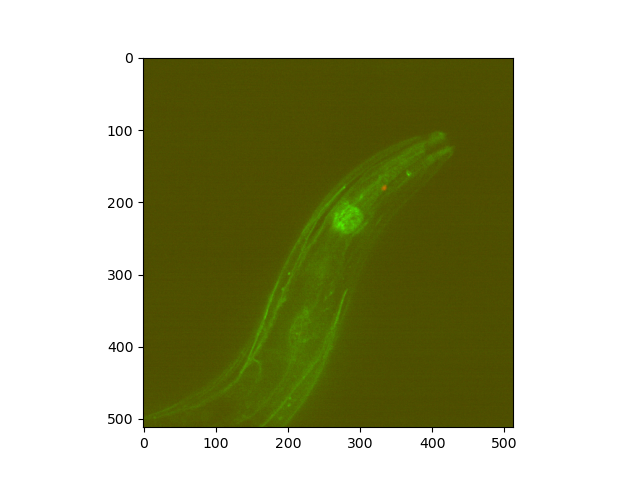

In [13]:
%matplotlib widget
i = 9
plt.figure()
plt.imshow(frames[i,:,:,:,0] / np.max(frames[i,:,:,:,0]))
plt.show()

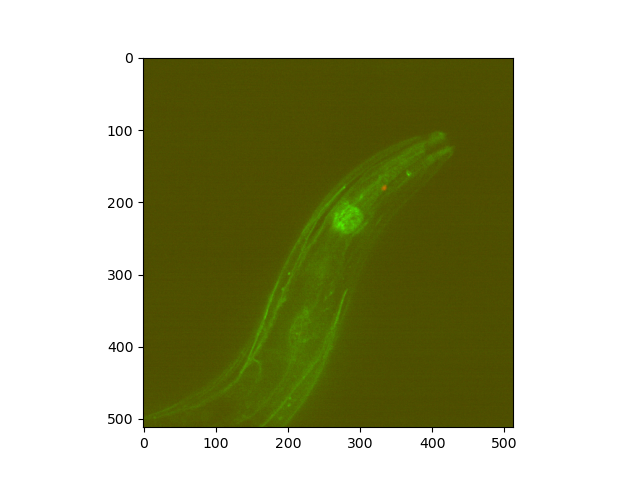

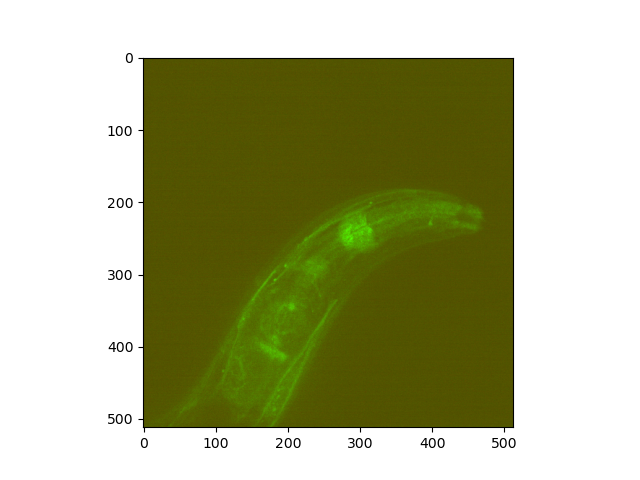

In [17]:
i = 9
plt.figure()
plt.imshow(frames[i,:,:,:,0] / np.max(frames[i,:,:,:,0]))
plt.show()
plt.figure()
plt.imshow(frames[i,:,:,:,40] / np.max(frames[i,:,:,:,40]))
plt.show()

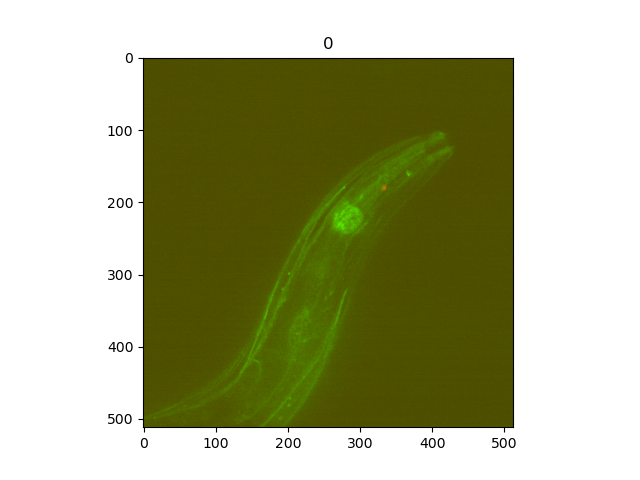

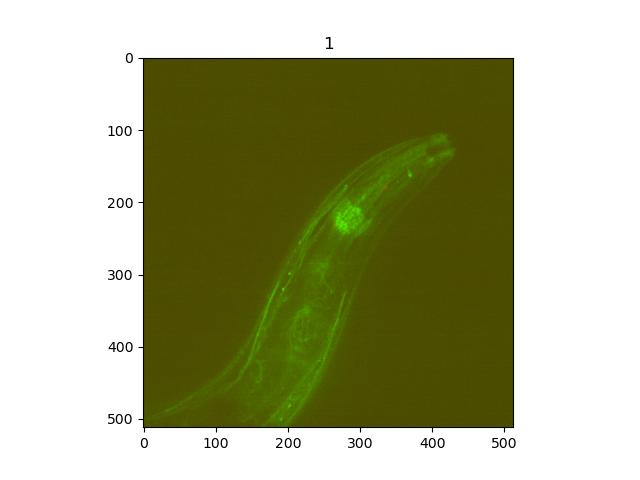

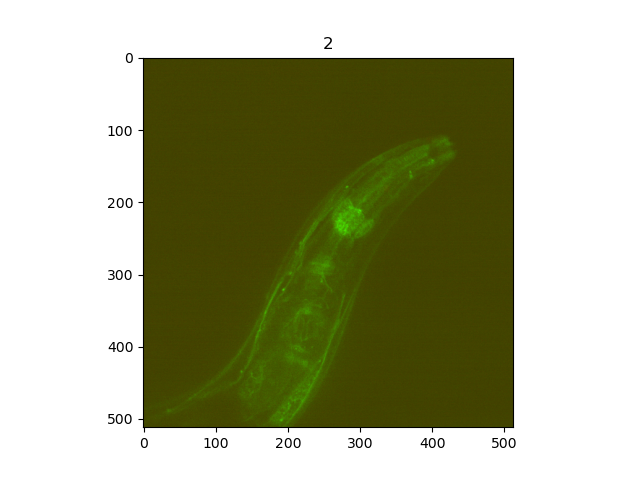

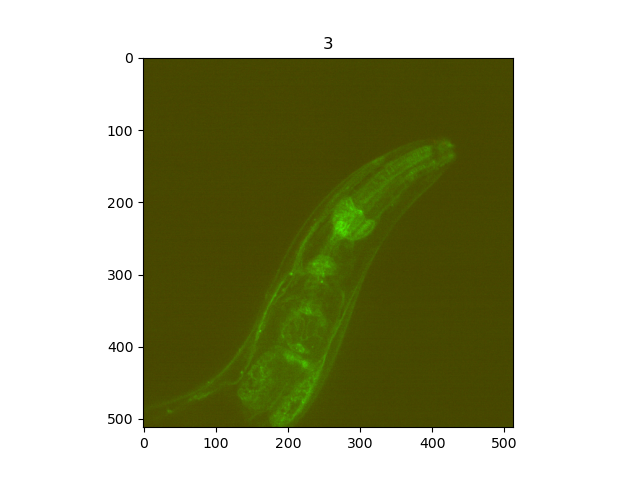

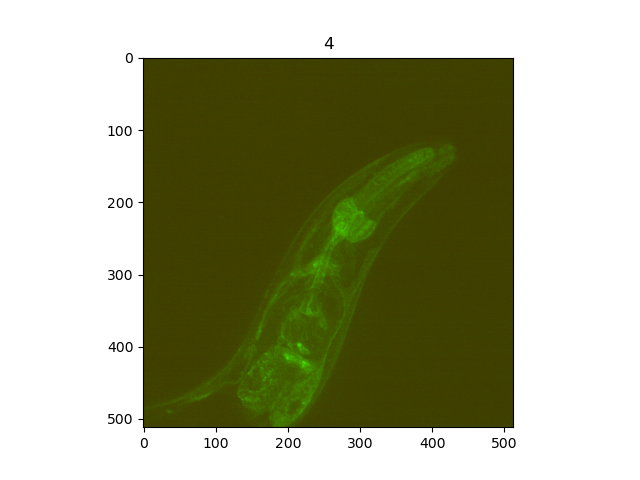

...

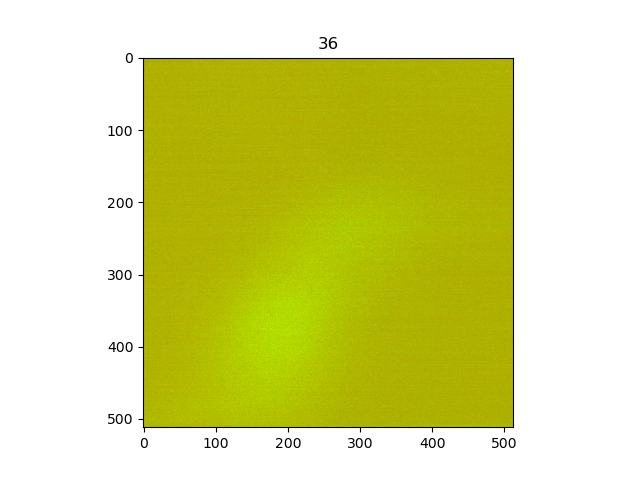

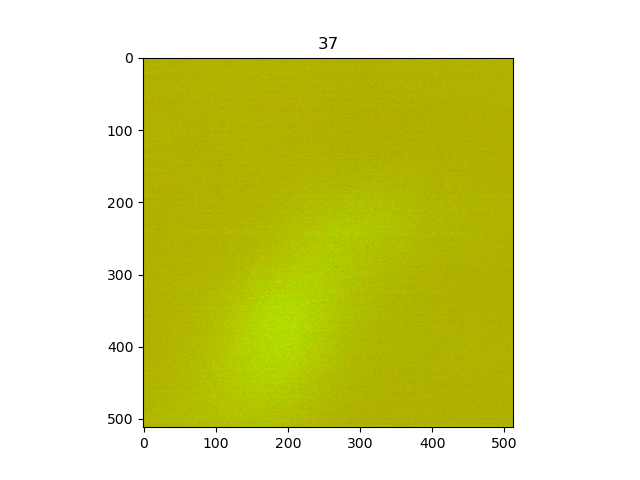

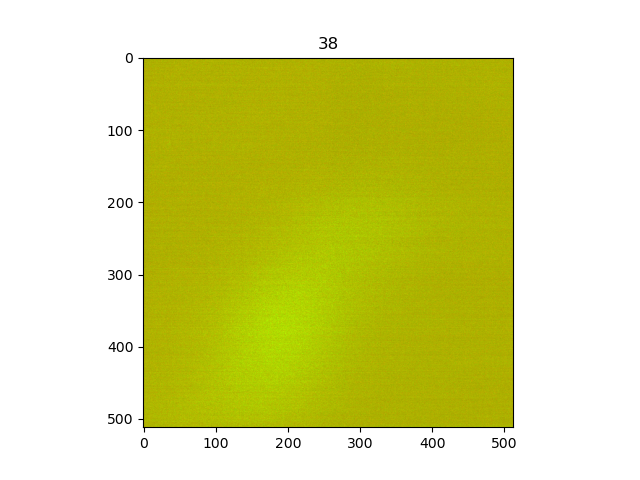

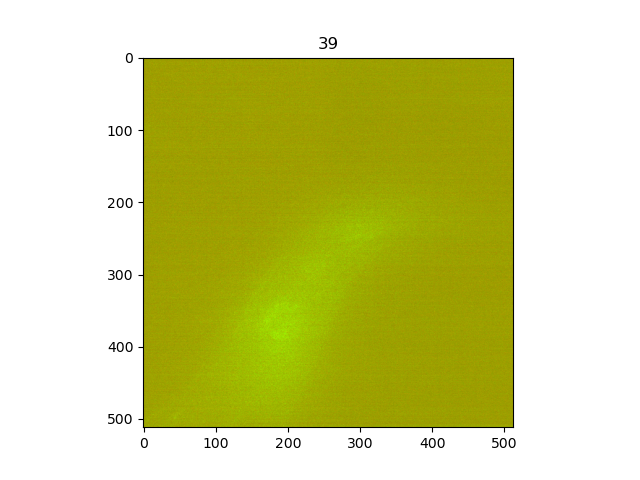

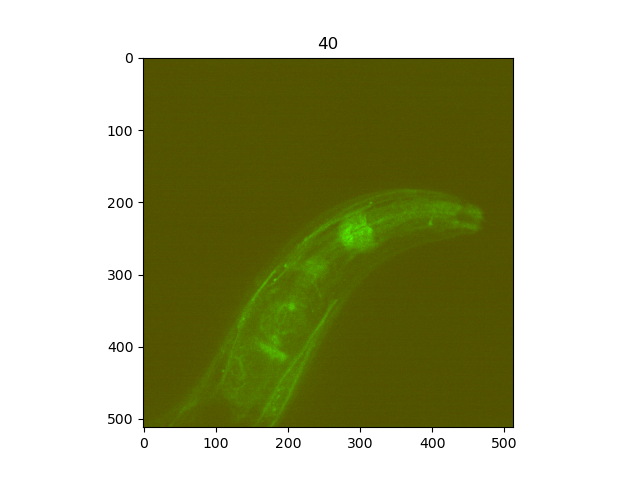

In [16]:
from matplotlib.pyplot import close as close_plots
close_plots()
for s in range(41):
    i = 9
    plt.figure()
    plt.imshow(frames[i,:,:,:,s] / np.max(frames[i,:,:,:,s]))
    plt.title(s)
    plt.show()